<p style="align: center;"><img align=center src="https://drive.google.com/uc?export=view&id=1I8kDikouqpH4hf7JBiSYAeNT2IO52T-T" width=600 height=480/></p>
<h3 style="text-align: center;"><b>Школа глубокого обучения ФПМИ МФТИ</b></h3>

<h3 style="text-align: center;"><b>Домашнее задание. Generative adversarial networks</b></h3>



В этом домашнем задании вы обучите GAN генерировать лица людей и посмотрите на то, как можно оценивать качество генерации

In [2]:
import os
from torch.utils.data import Dataset, DataLoader
import torchvision.datasets as dset
#from torchvision.datasets import ImageFolder
from torch.utils.tensorboard import SummaryWriter
import torch
import torch.nn as nn
import cv2
from pathlib import Path
import PIL
from PIL import Image

import torchvision
from torchvision import transforms

from tqdm.notebook import tqdm
from torchvision.utils import save_image
from torchvision.utils import make_grid
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
%matplotlib inline
import matplotlib.animation as animation
from IPython.display import HTML

sns.set(style='darkgrid', font_scale=1.2)

In [3]:
os.environ['CUDA_LAUNCH_BLOCKING'] = '1'

torch.backends.cudnn.benchmark = True
torch.backends.cudnn.enabled = True

## Часть 1. Подготовка данных (1 балл)

В качестве обучающей выборки возьмем часть датасета [Flickr Faces](https://github.com/NVlabs/ffhq-dataset), который содержит изображения лиц людей в высоком разрешении (1024х1024). Оригинальный датасет очень большой, поэтому мы возьмем его часть. Скачать датасет можно [здесь](https://drive.google.com/file/d/1KWPc4Pa7u2TWekUvNu9rTSO0U2eOlZA9/view?usp=sharing)

Давайте загрузим наши изображения. Напишите функцию, которая строит DataLoader для изображений, при этом меняя их размер до нужного значения (размер 1024 слишком большой, поэтому мы рекомендуем взять размер 128 либо немного больше)

In [4]:
# from google.colab import drive
# drive.mount('/content/drive')

In [1]:
!nvidia-smi --query-gpu=gpu_name,driver_version,memory.total --format=csv

name, driver_version, memory.total [MiB]
NVIDIA GeForce RTX 2070 SUPER, 470.86, 7959 MiB


In [6]:
# !unzip '/content/drive/MyDrive/Colab Notebooks/MFTI/GAN/faces_dataset_small.zip' >'/dev/null'

In [7]:
# !mkdir saved_examples
# !rm -rf faces_dataset_small/04000/ && mkdir ./faces_dataset_small/faceless
# !mv -v ./faces_dataset_small/* ./faces_dataset_small/faceless/ > /dev/null

In [8]:
data_dir = '/home/paul/Jypyter_Notebooks/MFTI/GAN/PICS'
device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')

BATCH_SIZE = 64
NUM_EPOCHS = 15
LR = 2e-4
BETTA1 = 0.5


CHANNELS_IMG = 3
#Latent space dim
Z_DIM = 100
FEATURES_DISC = 64
FEATURES_GEN = 64

RESNET_MEAN = 0.5
RESNET_STD = 0.5
IMAGE_SIZE = 64

WORKERS = 12

SAVE_MODEL = True
LOAD_MODEL = True
CHECKPOINT_GEN = "generator_dcgan_70k.pth"
CHECKPOINT_CRITIC = "disc_dcgan_70k.pth"

Я скачал около 70к картинок для тренировки Ганов

In [9]:
train_files = sorted(list(Path(data_dir).rglob('*png')))
print(f'Number of pictures in dir: {len(train_files)} pcs')

Number of pictures in dir: 66859 pcs


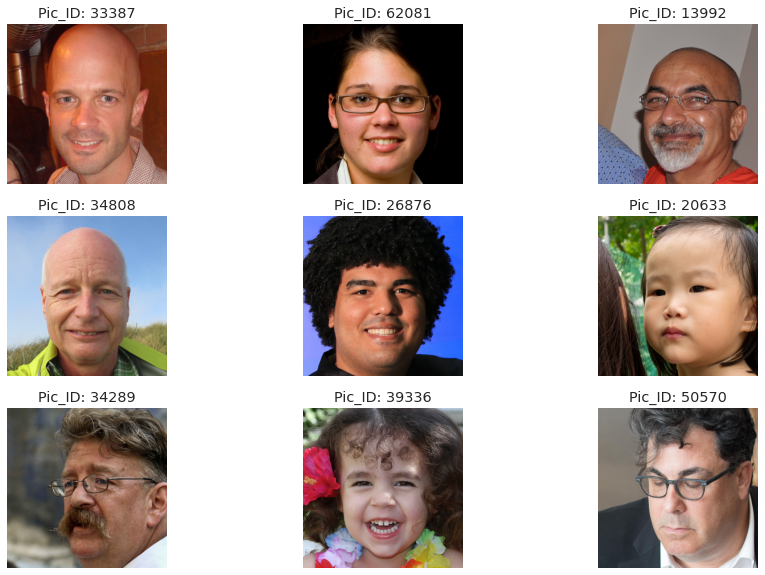

In [10]:
# Load pics
plt.figure(figsize = (15,10))
for i in range(9):
    rand_idx = int(np.random.uniform(0,len(train_files)))
    im = PIL.Image.open(train_files[rand_idx])
    plt.subplot(3, 3, i + 1)
    plt.imshow(im)
    label = (train_files[rand_idx]).stem
    plt.title('Pic_ID: ' + str(label))
    plt.axis('off')
plt.show()

Создадим класс датасета с возможностью кэшировать объекты

(Кэш не понадобился)

In [11]:
class FaceDataSet(Dataset):
    def __init__(self, files,use_cache=False):   
        self.files = files
        self.len_ = len(self.files)
        self.cached_data = []
        self.use_cache = use_cache
        self.transform =transforms.Compose([transforms.Resize(IMAGE_SIZE),
                                            transforms.CenterCrop(IMAGE_SIZE),
                                            transforms.ToTensor(),
                                            transforms.Normalize(
                                                [RESNET_MEAN for _ in range(CHANNELS_IMG)],
                                                [RESNET_STD for _ in range(CHANNELS_IMG)]),
                                            ])
           
    def load_sample(self, file):
        image = Image.open(file)
        image.load()
        img_id = file.stem
        return image, img_id
    
    def __getitem__(self,index):
        if not self.use_cache:
            img,img_id = self.load_sample(self.files[index]) 
            img = self.transform(img) 
            self.cached_data.append(img)
        else:
            img = self.cached_data[index]             
        return img
    
    def set_use_cache(self, use_cache):
        if use_cache:
            x_img = tuple(self.cached_data)
            self.cached_data = torch.stack(x_img)
        else:
            self.cached_data = []
        self.use_cache = use_cache
    
    def __len__(self):
        return self.len_

In [12]:
dataset = FaceDataSet(train_files,use_cache=False)

In [13]:
loader = DataLoader(dataset,
                    batch_size=BATCH_SIZE,
                    shuffle=True,
                    pin_memory=True,
                    num_workers=WORKERS,)

In [14]:
# Проверим, что на выходе дает датасет с лоадером
images = next(iter(loader))
assert images.shape == (BATCH_SIZE,CHANNELS_IMG,IMAGE_SIZE,IMAGE_SIZE ), "DSET FAILED"
print(f"image shape: {images.shape}")

image shape: torch.Size([64, 3, 64, 64])


In [15]:
def save_checkpoint(model, optimizer, filename="my_checkpoint.pth.tar"):
    '''
    Функция для сохранения весов модели
    '''
    print("=> Saving checkpoint")
    checkpoint = {
        "state_dict": model.state_dict(),
        "optimizer": optimizer.state_dict(),
    }
    torch.save(checkpoint, filename)

In [16]:
def load_checkpoint(checkpoint_file, model, optimizer, lr):
    '''
    Функция для загузки весов модели
    '''
    print("=> Loading checkpoint")
    checkpoint = torch.load(checkpoint_file, map_location="cuda")
    model.load_state_dict(checkpoint["state_dict"])
    optimizer.load_state_dict(checkpoint["optimizer"])

    # If we don't do this then it will just have learning rate of old checkpoint
    # and it will lead to many hours of debugging \:
    for param_group in optimizer.param_groups:
        param_group["lr"] = lr

## Часть 2. Построение и обучение модели (2 балла)

Сконструируйте генератор и дискриминатор. Помните, что:
* дискриминатор принимает на вход изображение (тензор размера `3 x image_size x image_size`) и выдает вероятность того, что изображение настоящее (тензор размера 1)

* генератор принимает на вход тензор шумов размера `latent_size x 1 x 1` и генерирует изображение размера `3 x image_size x image_size`

In [17]:
class Discriminator(nn.Module):
    def __init__(self, ngpu):
        super(Discriminator, self).__init__()
        self.ngpu = ngpu
        self.main = nn.Sequential(
            # input is (nc) x 64 x 64
            nn.Conv2d(CHANNELS_IMG, FEATURES_DISC, 4, 2, 1, bias=False),
            nn.LeakyReLU(0.2, inplace=True),
            # state size. (FEATURES_DISC) x 32 x 32
            nn.Conv2d(FEATURES_DISC, FEATURES_DISC * 2, 4, 2, 1, bias=False),
            nn.BatchNorm2d(FEATURES_DISC * 2),
            nn.LeakyReLU(0.2, inplace=True),
            # state size. (ndf*2) x 16 x 16
            nn.Conv2d(FEATURES_DISC * 2, FEATURES_DISC * 4, 4, 2, 1, bias=False),
            nn.BatchNorm2d(FEATURES_DISC * 4),
            nn.LeakyReLU(0.2, inplace=True),
            # state size. (ndf*4) x 8 x 8
            nn.Conv2d(FEATURES_DISC * 4, FEATURES_DISC * 8, 4, 2, 1, bias=False),
            nn.BatchNorm2d(FEATURES_DISC * 8),
            nn.LeakyReLU(0.2, inplace=True),
            # state size. (ndf*8) x 4 x 4
            nn.Conv2d(FEATURES_DISC * 8, 1, 4, 1, 0, bias=False),
            nn.Sigmoid()
        )

    def forward(self, input):
        return self.main(input)

In [18]:
class Generator(nn.Module):
    def __init__(self, ngpu):
        super(Generator, self).__init__()
        self.ngpu = ngpu
        self.main = nn.Sequential(
            # input is Z, going into a convolution
            nn.ConvTranspose2d( Z_DIM, FEATURES_GEN * 8, 4, 1, 0, bias=False),
            nn.BatchNorm2d(FEATURES_GEN * 8),
            nn.ReLU(True),
            # state size. (ngf*8) x 4 x 4
            nn.ConvTranspose2d(FEATURES_GEN * 8, FEATURES_GEN * 4, 4, 2, 1, bias=False),
            nn.BatchNorm2d(FEATURES_GEN * 4),
            nn.ReLU(True),
            # state size. (ngf*4) x 8 x 8
            nn.ConvTranspose2d( FEATURES_GEN * 4, FEATURES_GEN * 2, 4, 2, 1, bias=False),
            nn.BatchNorm2d(FEATURES_GEN * 2),
            nn.ReLU(True),
            # state size. (ngf*2) x 16 x 16
            nn.ConvTranspose2d( FEATURES_GEN * 2, FEATURES_GEN, 4, 2, 1, bias=False),
            nn.BatchNorm2d(FEATURES_GEN),
            nn.ReLU(True),
            # state size. (ngf) x 32 x 32
            nn.ConvTranspose2d( FEATURES_GEN, CHANNELS_IMG, 4, 2, 1, bias=False),
            nn.Tanh()
            # state size. (nc) x 64 x 64
        )

    def forward(self, input):
        return self.main(input)

In [19]:
def initialize_weights(model):
    classname = model.__class__.__name__
    if classname.find('Conv') != -1:
        nn.init.normal_(model.weight.data, 0.0, 0.02)
    elif classname.find('BatchNorm') != -1:
        nn.init.normal_(model.weight.data, 1.0, 0.02)
        nn.init.constant_(model.bias.data, 0)

In [20]:
# Протестируем, что модель возвращает ожидаемые размеры тензоров
def test():
    N, in_channels, H, W = 8, 3, 64, 64
    noise_dim = 100
    x = torch.randn((N, in_channels, H, W))
    disc = Discriminator(1)
    print(disc(x).shape)
    assert disc(x).shape == (N, 1, 1, 1), "Discriminator test failed"
    gen = Generator(1)
    initialize_weights(gen)
    z = torch.randn((N, noise_dim, 1, 1))
    assert gen(z).shape == (N, in_channels, H, W), "Generator test failed"
    print(gen(z).shape)

In [21]:
test()

torch.Size([8, 1, 1, 1])
torch.Size([8, 3, 64, 64])


In [22]:
# Время от времени будем печатать потери в tensorboard
def plot_to_tensorboard(
    writer, loss_critic, loss_gen, real, fake, tensorboard_step
):
    writer.add_scalar("Loss Critic", loss_critic, global_step=tensorboard_step)
    writer.add_scalar("Loss Gen", loss_gen, global_step=tensorboard_step)

    with torch.no_grad():
        # take out (up to) 8 examples to plot
        img_grid_real = torchvision.utils.make_grid(real[:8], normalize=True)
        img_grid_fake = torchvision.utils.make_grid(fake[:8], normalize=True)
        writer.add_image("Real", img_grid_real, global_step=tensorboard_step)
        writer.add_image("Fake", img_grid_fake, global_step=tensorboard_step)

In [23]:
def generate_examples(gen, n=100, device = device):
    """
    Tried using truncation trick here but not sure it actually helped anything, you can
    remove it if you like and just sample from torch.randn
    """
    gen.eval()
    for i in range(n):
        with torch.no_grad():
            noise = torch.randn(1,Z_DIM, 1, 1).to(device)
            img = gen(noise)
            save_image(img*0.5+0.5, f"saved_examples/img_{i}.png")
    gen.train()

Перейдем теперь к обучению нашего GANа. Алгоритм обучения следующий:
1. Учим дискриминатор:
  * берем реальные изображения и присваиваем им метку 1
  * генерируем изображения генератором и присваиваем им метку 0
  * обучаем классификатор на два класса

2. Учим генератор:
  * генерируем изображения генератором и присваиваем им метку 0
  * предсказываем дискриминаторором, реальное это изображение или нет


В качестве функции потерь берем бинарную кросс-энтропию

In [24]:
# Определим генератор и дискриминатор
gen = Generator(1).to(device)
disc = Discriminator(1).to(device)

# Инициализируем веса
gen.apply(initialize_weights)
disc.apply(initialize_weights)

Discriminator(
  (main): Sequential(
    (0): Conv2d(3, 64, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (1): LeakyReLU(negative_slope=0.2, inplace=True)
    (2): Conv2d(64, 128, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (3): BatchNorm2d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (4): LeakyReLU(negative_slope=0.2, inplace=True)
    (5): Conv2d(128, 256, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (6): BatchNorm2d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (7): LeakyReLU(negative_slope=0.2, inplace=True)
    (8): Conv2d(256, 512, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (9): BatchNorm2d(512, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (10): LeakyReLU(negative_slope=0.2, inplace=True)
    (11): Conv2d(512, 1, kernel_size=(4, 4), stride=(1, 1), bias=False)
    (12): Sigmoid()
  )
)

In [25]:
# Оптимайзеры и лосс функция
opt_gen = torch.optim.Adam(gen.parameters(), lr=LR, betas=(BETTA1, 0.999))
opt_disc = torch.optim.Adam(disc.parameters(), lr=LR, betas=(BETTA1, 0.999))
criterion = nn.BCELoss()

In [26]:
# загрузим обученную модель (если обучали ранее)
if LOAD_MODEL:
        load_checkpoint(
            CHECKPOINT_GEN, gen, opt_gen, LR,
        )
        load_checkpoint(
            CHECKPOINT_CRITIC, disc, opt_disc,LR,
        )

=> Loading checkpoint
=> Loading checkpoint


In [27]:
fixed_noise = torch.randn(64,Z_DIM, 1, 1).to(device)
writer = SummaryWriter(f"logs_dcgan/DCGAN")
tensorboard_step = 0
real_label = 1. 
fake_label = 0.

In [27]:
# Training Loop

# Lists to keep track of progress
img_list = []
G_losses = []
D_losses = []
step = 0
iters = 0
print("Starting Training Loop...")

for epoch in range(NUM_EPOCHS):
  for i, data in enumerate(loader, 0):
    opt_disc.zero_grad()
    real_cpu = data.to(device)
    b_size = real_cpu.size(0)
    label = torch.full((b_size,), real_label, dtype=torch.float, device=device)
    # Forward pass real batch through D
    output = disc(real_cpu).view(-1)
    # Calculate loss on all-real batch
    errD_real = criterion(output, label)
    errD_real.backward()
    D_x = output.mean().item()

    ## Train with all-fake batch
    # Generate batch of latent vectors
    noise = torch.randn(b_size, Z_DIM, 1, 1, device=device)
    fake = gen(noise)
    label.fill_(fake_label)
    output = disc(fake.detach()).view(-1)
    errD_fake = criterion(output, label)
    errD_fake.backward()
    D_G_z1 = output.mean().item()
    # Compute error of D as sum over the fake and the real batches
    errD = errD_real + errD_fake
    opt_disc.step()

    # (2) Update G network: maximize log(D(G(z)))
    opt_gen.zero_grad()
    label.fill_(real_label)  # fake labels are real for generator cost
    # Since we just updated D, perform another forward pass of all-fake batch through D
    output = disc(fake).view(-1)
    # Calculate G's loss based on this output
    errG = criterion(output, label)
    errG.backward()
    D_G_z2 = output.mean().item()
    # Update G
    opt_gen.step()

    # Output training stats
    if i % 500 == 0:
       print('[%d/%d][%d/%d]\tLoss_D: %.4f\tLoss_G: %.4f\tD(x): %.4f\tD(G(z)): %.4f / %.4f'
                  % (epoch, NUM_EPOCHS, i, len(loader),
                     errD.item(), errG.item(), D_x, D_G_z1, D_G_z2))
       # Save Losses for plotting later
       G_losses.append(errG.item())
       D_losses.append(errD.item())
      
    if i % 500 == 0:
      with torch.no_grad():
        fixed_fakes = gen(fixed_noise)
        plot_to_tensorboard(writer,
                            errD.item(),
                            errG.item(), 
                            data.detach(),
                            fixed_fakes.detach(),
                            tensorboard_step)
      tensorboard_step += 1
      fixed_fakes = fixed_fakes.detach().cpu()
      img_list.append(make_grid(fixed_fakes, padding=2, normalize=True))
      if SAVE_MODEL:
                save_checkpoint(gen, opt_gen, 
                                filename=f'Epoch_{epoch}_iter{i}_{CHECKPOINT_GEN}')
                save_checkpoint(disc, 
                                opt_disc, filename=f'Epoch_{epoch}_iter{i}_{CHECKPOINT_CRITIC}')
        
        
    iters += 1
    generate_examples(gen)
    

Starting Training Loop...
[0/15][0/1045]	Loss_D: 0.2034	Loss_G: 3.0899	D(x): 0.8766	D(G(z)): 0.0556 / 0.0737
=> Saving checkpoint
=> Saving checkpoint
[0/15][500/1045]	Loss_D: 0.1618	Loss_G: 4.6694	D(x): 0.9612	D(G(z)): 0.1008 / 0.0154
=> Saving checkpoint
=> Saving checkpoint
[0/15][1000/1045]	Loss_D: 2.1501	Loss_G: 12.8861	D(x): 0.9980	D(G(z)): 0.7808 / 0.0000
=> Saving checkpoint
=> Saving checkpoint
[1/15][0/1045]	Loss_D: 0.4579	Loss_G: 3.4771	D(x): 0.7252	D(G(z)): 0.0265 / 0.0700
=> Saving checkpoint
=> Saving checkpoint
[1/15][500/1045]	Loss_D: 0.1126	Loss_G: 5.8488	D(x): 0.9202	D(G(z)): 0.0235 / 0.0079
=> Saving checkpoint
=> Saving checkpoint
[1/15][1000/1045]	Loss_D: 0.1205	Loss_G: 4.8594	D(x): 0.9836	D(G(z)): 0.0915 / 0.0135
=> Saving checkpoint
=> Saving checkpoint
[2/15][0/1045]	Loss_D: 0.1234	Loss_G: 4.7800	D(x): 0.9137	D(G(z)): 0.0222 / 0.0177
=> Saving checkpoint
=> Saving checkpoint
[2/15][500/1045]	Loss_D: 0.0897	Loss_G: 4.3374	D(x): 0.9675	D(G(z)): 0.0503 / 0.0276
=> 

Постройте графики лосса для генератора и дискриминатора. Что вы можете сказать про эти графики?

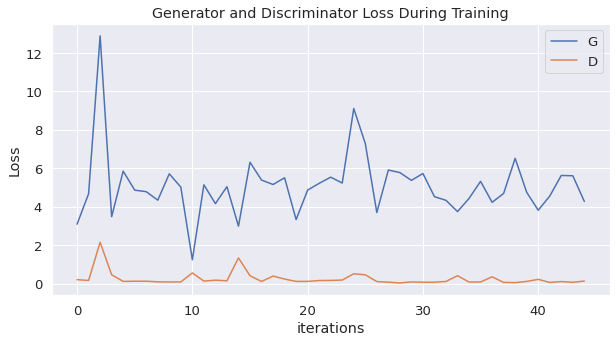

In [30]:
plt.figure(figsize=(10,5))
plt.title("Generator and Discriminator Loss During Training")
plt.plot(G_losses,label="G")
plt.plot(D_losses,label="D")
plt.xlabel("iterations")
plt.ylabel("Loss")
plt.legend()
plt.show()

Посмотрим, что там модель генерила во время обучения

Animation size has reached 21056306 bytes, exceeding the limit of 20971520.0. If you're sure you want a larger animation embedded, set the animation.embed_limit rc parameter to a larger value (in MB). This and further frames will be dropped.


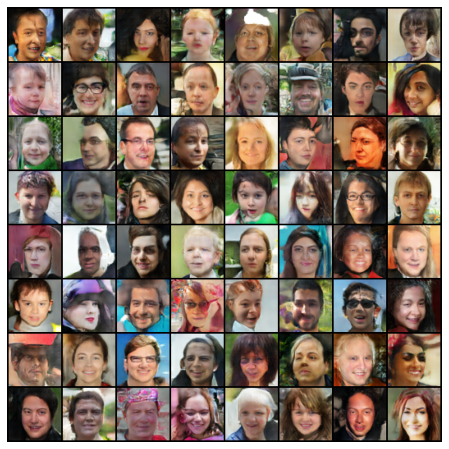

In [32]:
#%%capture
fig = plt.figure(figsize=(8,8))
plt.axis("off")
ims = [[plt.imshow(np.transpose(i,(1,2,0)), animated=True)] for i in img_list]
ani = animation.ArtistAnimation(fig, ims, interval=1000, repeat_delay=1000, blit=True)

HTML(ani.to_jshtml())

## Часть 3. Генерация изображений (1 балл)

Теперь давайте оценим качество получившихся изображений. Напишите функцию, которая выводит изображения, сгенерированные нашим генератором

In [35]:
with torch.no_grad():
  gen_pics = gen(fixed_noise)

In [36]:
# Возьмем 4000 примеров
generate_examples(gen,n=4000)
generated_img = sorted(list(Path(generated_img_path).rglob('*png')))

In [37]:
generated_img_path = './saved_examples'
generated_img = sorted(list(Path(generated_img_path).rglob('*png')))
print(f'Number of pictures in dir: {len(generated_img)} pcs')

Number of pictures in dir: 4000 pcs


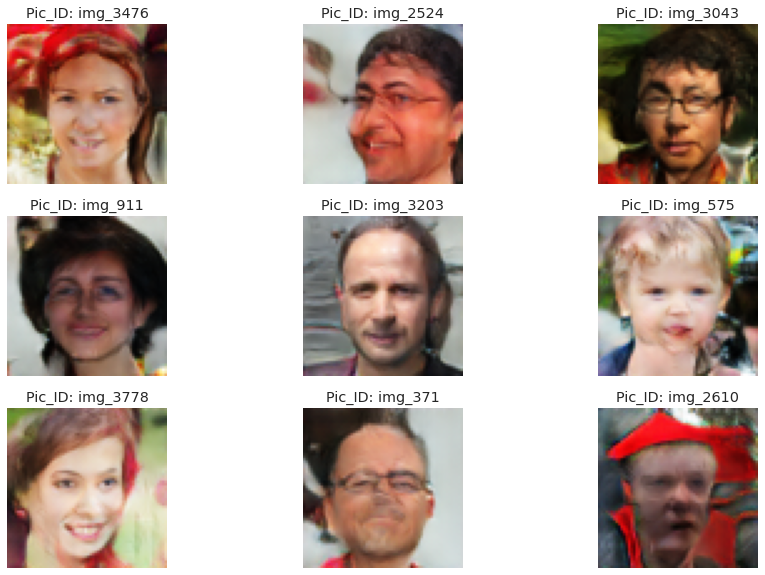

In [51]:
# Load pics
plt.figure(figsize = (15,10))
for i in range(9):
    rand_idx = int(np.random.uniform(0,len(generated_img)))
    im = PIL.Image.open(generated_img[rand_idx])
    plt.subplot(3, 3, i + 1)
    plt.imshow(im)
    label = (generated_img[rand_idx]).stem
    plt.title('Pic_ID: ' + str(label))
    plt.axis('off')
plt.show()

Как вам качество получившихся изображений?

Не очень :(

## Часть 4. Leave-one-out-1-NN classifier accuracy (6 баллов)

### 4.1. Подсчет accuracy (4 балла)

Не всегда бывает удобно оценивать качество сгенерированных картинок глазами. В качестве альтернативы вам предлагается реализовать следующий подход:
  * Сгенерировать столько же фейковых изображений, сколько есть настоящих в обучающей выборке. Присвоить фейковым метку класса 0, настоящим – 1.
  * Построить leave-one-out оценку: обучить 1NN Classifier (`sklearn.neighbors.KNeighborsClassifier(n_neighbors=1)`) предсказывать класс на всех объектах, кроме одного, проверить качество (accuracy) на оставшемся объекте. В этом вам поможет `sklearn.model_selection.LeaveOneOut`

In [52]:
import pandas as pd

In [53]:
df = pd.DataFrame(data=None)

In [55]:
def get_flat(files,label,real=True):#(df,label,file):
  arr = np.empty((1, CHANNELS_IMG*IMAGE_SIZE*IMAGE_SIZE))
  for file in files:
    image = Image.open(file)
    image.load()
    if real:
      resize = transforms.Resize(IMAGE_SIZE)
      image = resize(image)
      
    img = np.array(image)
    img = img.flatten()
    img = np.expand_dims(img, axis=0)
    arr = np.vstack((arr,img))
  df_t = pd.DataFrame(data=arr[1:])
  df_t['label'] = label
  return df_t

In [56]:
fake_img = get_flat(generated_img,0, real=False)

In [57]:
real_img =  get_flat(train_files[:4000],1, real=True)

In [58]:
train_df = pd.concat([fake_img,real_img])

In [59]:
from sklearn.neighbors import KNeighborsClassifier
from sklearn.model_selection import LeaveOneOut
from sklearn.metrics import accuracy_score

In [60]:
loo = LeaveOneOut()

In [61]:
y = train_df[train_df.columns[-1]].values
X = train_df[train_df.columns[:-1]].values

In [63]:
error = []
actual = []
predicted = []

In [64]:
for train_index ,test_index in loo.split(X):
  #print("TRAIN:", train_index, "TEST:", test_index)
  X_train, X_test = X[train_index], X[test_index]
  y_train, y_test = y[train_index], y[test_index]
  classifier = KNeighborsClassifier(n_neighbors=1)
  classifier.fit(X_train, y_train)
  y_pred = classifier.predict(X_test)
  # Append the single predictions and actual values here.
  actual.append(y_test[0])
  predicted.append(y_pred[0])

# Outside the loop, calculate the error.
error.append(np.mean(np.array(predicted) != np.array(actual)))

In [65]:
accuracy_score(actual, predicted)

0.60825

Что вы можете сказать о получившемся результате? Какой accuracy мы хотели бы получить и почему?

Можно сказать, что классификатор способен отличить фэйк от реального изображения. Хотелось бы получить  точность в 0.5. 

Это бы говорило о том, что наша точность сравни бросанию монетки. 

Другими словами, классификатор не способен отличить фэйк от реального изображения

### 4.2. Визуализация распределений (2 балла)

Давайте посмотрим на то, насколько похожи распределения настоящих и фейковых изображений. Для этого воспользуйтесь методом, снижающим размерность (к примеру, TSNE) и изобразите на графике разным цветом точки, соответствующие реальным и сгенерированным изображенияи

Прокомментируйте получившийся результат:

In [66]:
from sklearn.manifold import TSNE
import plotly.express as px

In [67]:
tsne = TSNE(n_components=2)
tsne_results = tsne.fit_transform(train_df.drop(['label'],axis=1))

In [68]:
fig = px.scatter(tsne_results,
                 x=0,
                 y=1,
                 color=train_df.label.astype(str),
                 labels={'0': 'tsne-2d-one', '1': 'tsne-2d-two'})
fig.show()

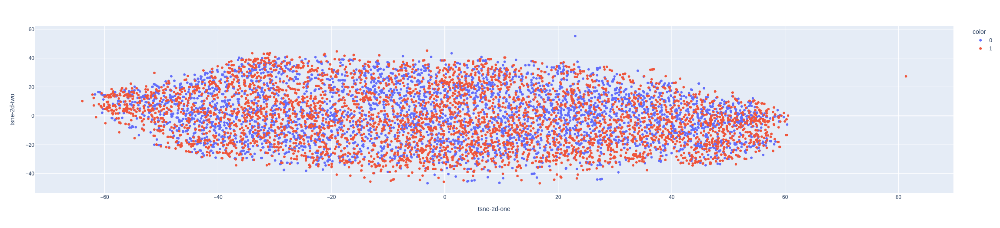

Данные точки смешаны и тяжело визуально определить какой либо кластер данных. Хотя модель классификатора и смогла разделить данные с точностью 60%